In [1]:
from glob import glob
import numpy as np
import os
import warnings
warnings.filterwarnings("ignore")
import sys
sys.path.append("../../tools")
from plot_tools import plot_uv_map,plot_map_zoom
import xarray as xr
import matplotlib.pyplot as plt
import pickle
import gzip
import numpy
import netCDF4
import datetime
import os
from typing import Optional, Tuple

FMT = '%Y-%m-%dT%H:%M:%S.%fZ'

In [3]:
time_min = '2010-01-01'                                        # time min for analysis
time_max = '2010-12-31'  

# Grid map 
maps_glorys = xr.open_dataset("/Odyssey/private/t22picar/data/glorys_15m/glorys_multivar_15m_2010-2018.nc").sel(time="2010-01-01")
lon_bins = np.linspace(-180.125, 179.9 + 0.125, 1441)
lat_bins = np.linspace(-80.125, 90.125, 680)


def compute_hist(ds_drifter):

    # Supposons que les variables de longitude et latitude soient nommées 'longitude' et 'latitude'
    longitude = ds_drifter['lon'].values
    latitude = ds_drifter['lat'].values

    # Calculer le nombre de données dans chaque bin 2D
    histogram, lat_edges, lon_edges = np.histogram2d(
        latitude, longitude, bins=[lat_bins, lon_bins]
    )

    # Convertir le résultat en xarray.DataArray pour une manipulation plus facile
    histogram_da = xr.DataArray(
        histogram,
        coords=[('lat_bin', lat_edges[:-1]), ('lon_bin', lon_edges[:-1])],
        dims=['lat_bin', 'lon_bin'])
    
    return(histogram_da)
    

In [5]:
type_data = "cmems_00m"

year=2010
filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/{type_data}/drifter_*_{year}.nc'))
ds_drifter = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')

for year in range(2011,2019):
    print(year)
    filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/{type_data}/drifter_*_{year}.nc'))
    ds_drifter_aoml = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')
    ds_drifter=xr.concat([ds_drifter_aoml, ds_drifter], dim="date")
    
histogram_da = compute_hist(ds_drifter)
plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=100,colorbar_title="nb data",cmap=plt.cm.Reds,title="2010-1018")
plt.savefig(f"plot/{type_data}/hist_drifter_{type_data}_2010-2018.png")
plt.show()

2011
2012
2013
2014
2015
2016
2017
2018


KeyboardInterrupt: 

2011
2012
2013
2014
2015
2016
2017
2018


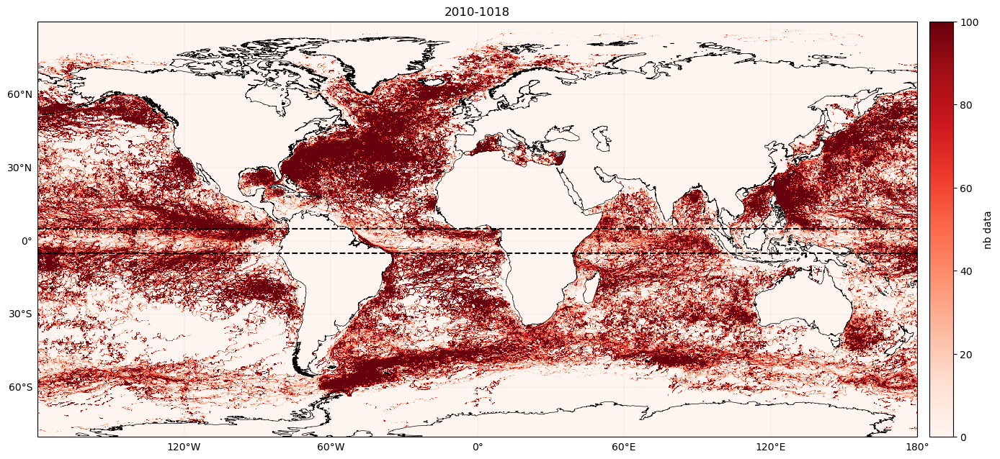

In [4]:
year=2010
filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/aoml/drifter_*_{year}.nc'))
ds_drifter = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')

for year in range(2011,2019):
    print(year)
    filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/aoml/drifter_*_{year}.nc'))
    ds_drifter_aoml = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')
    ds_drifter=xr.concat([ds_drifter_aoml, ds_drifter], dim="date")
    
histogram_da = compute_hist(ds_drifter)
plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=100,colorbar_title="nb data",cmap=plt.cm.Reds,title="2010-1018")
plt.savefig(f"plot/aoml/hist_drifter_aoml_2010-2018.png")
plt.show()

2011
2012
2013
2014
2015
2016
2017
2018


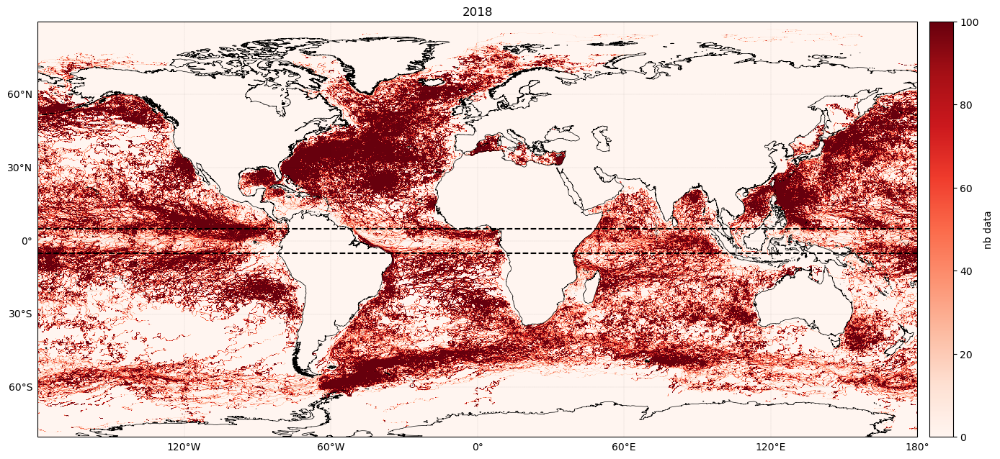

In [4]:
year=2010
filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/aoml/drifter_*_{year}.nc'))
ds_drifter = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')

for year in range(2011,2019):
    print(year)
    filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/aoml/drifter_*_{year}.nc'))
    ds_drifter_aoml = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')
    ds_drifter=xr.concat([ds_drifter_aoml, ds_drifter], dim="date")
    
histogram_da = compute_hist(ds_drifter)
plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=100,colorbar_title="nb data",cmap=plt.cm.Reds,title=year)
plt.savefig(f"plot/aoml+cmems/hist_drifter_aoml_2010-2019.png")
plt.show()

2010


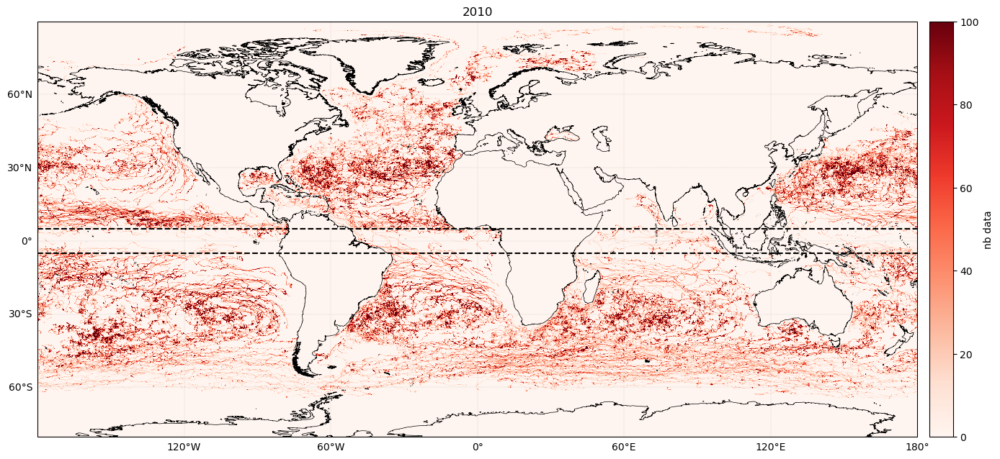

2011


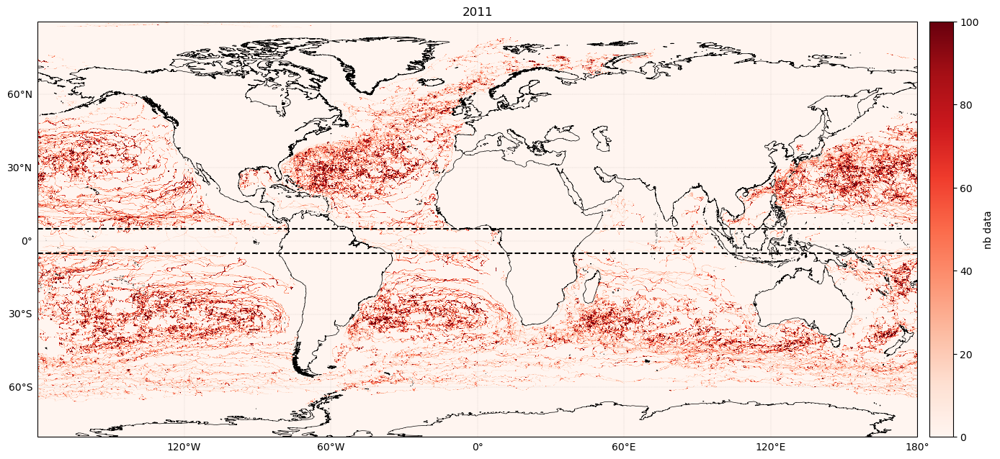

2012


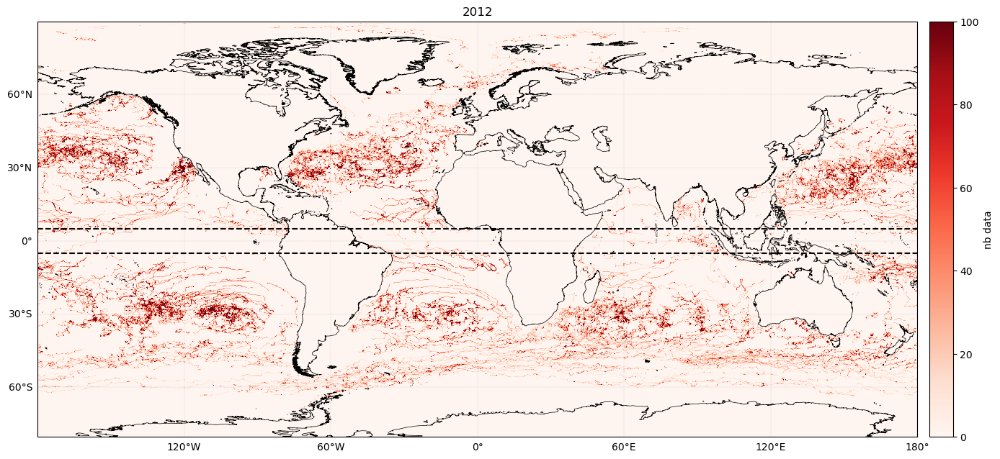

2013


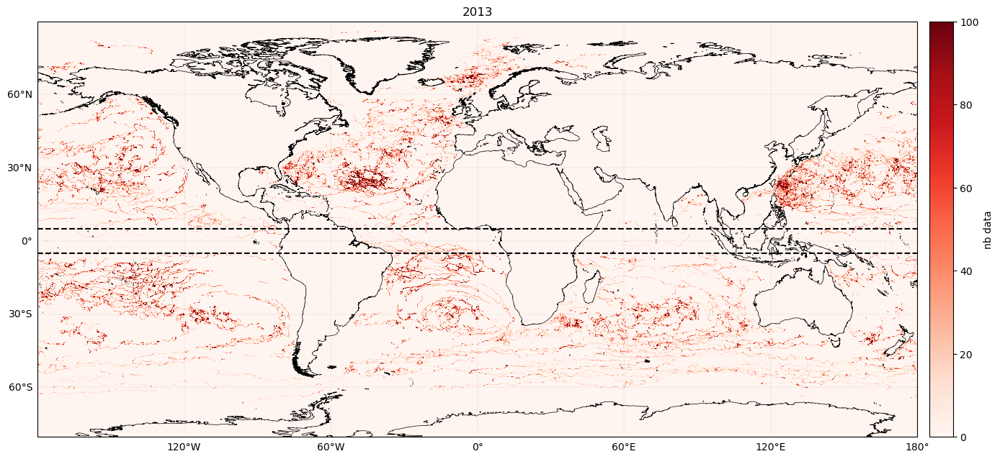

2014


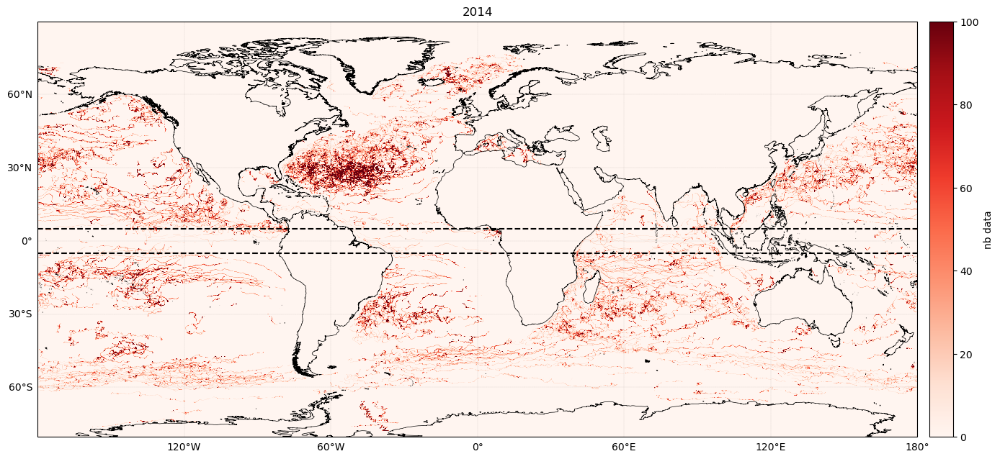

2015


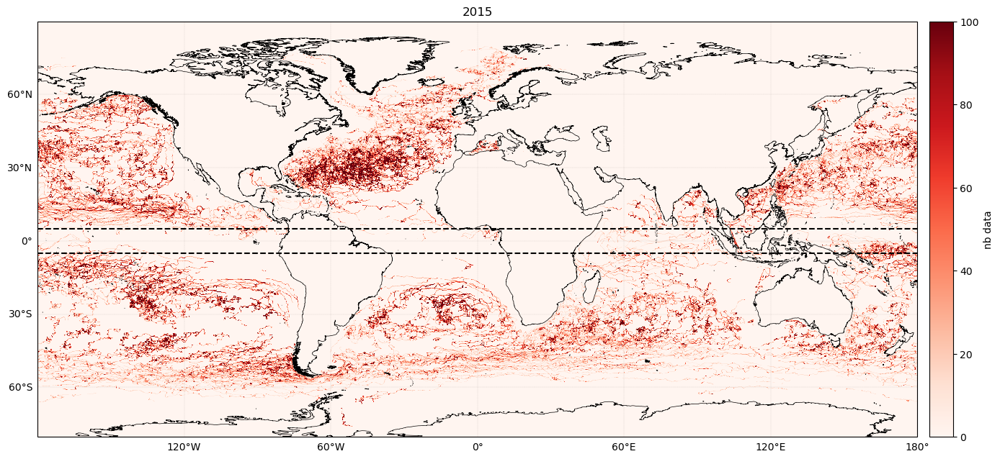

2016


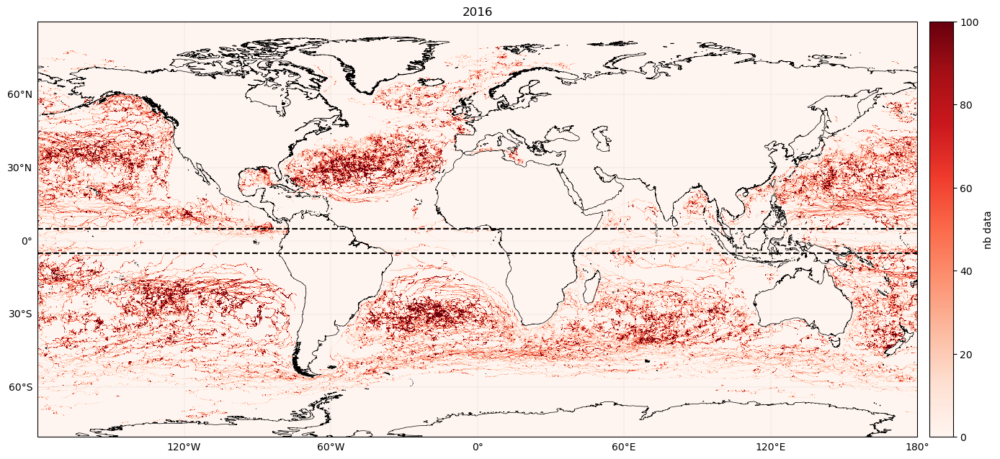

2017


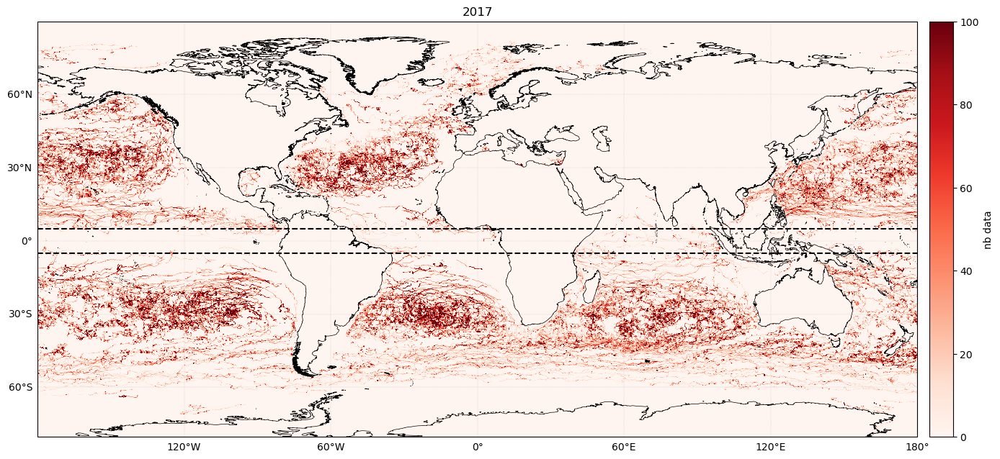

2018


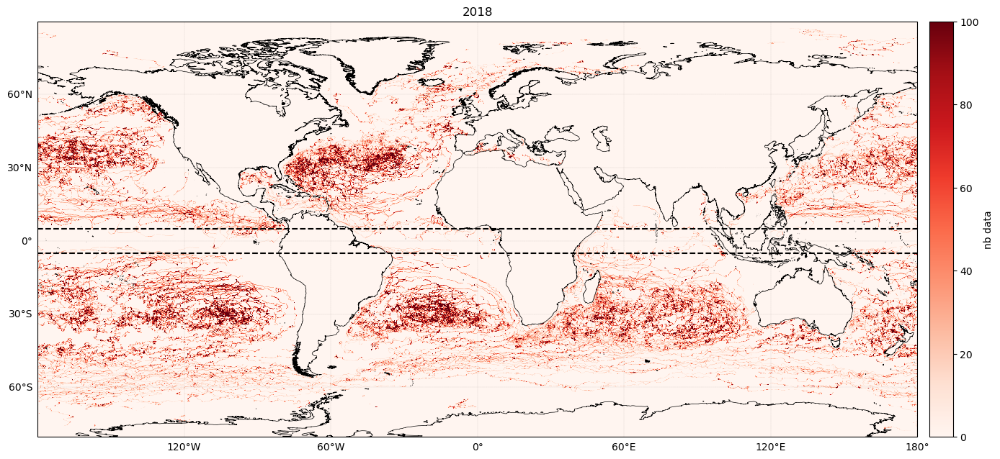

2019


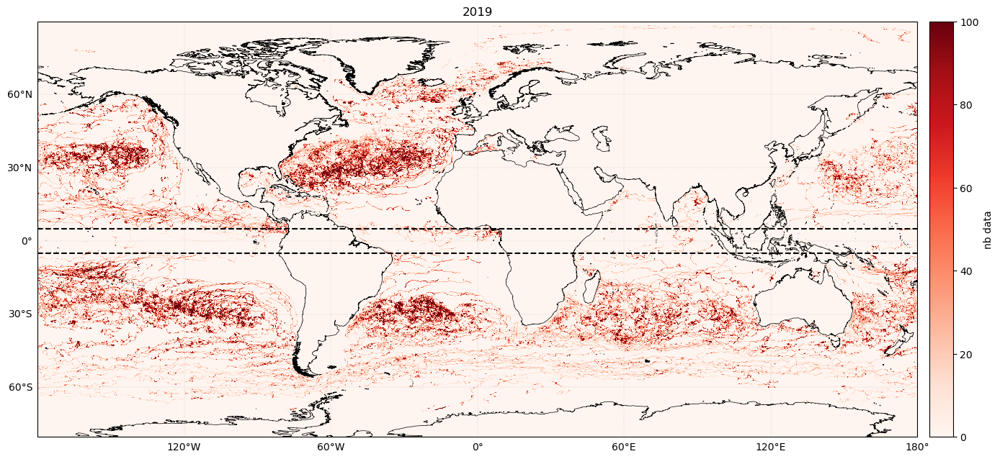

In [3]:
for year in range(2010,2020):
    print(year)
    filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/aoml_00m/drifter_*_{year}.nc'))
    ds_drifter = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')
    histogram_da = compute_hist(ds_drifter)
    plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=100,colorbar_title="nb data",cmap=plt.cm.Reds,title=year)
    plt.savefig(f"plot/aoml_00m/hist_drifter_aoml_00m_{year}.png")
    plt.show()


2010


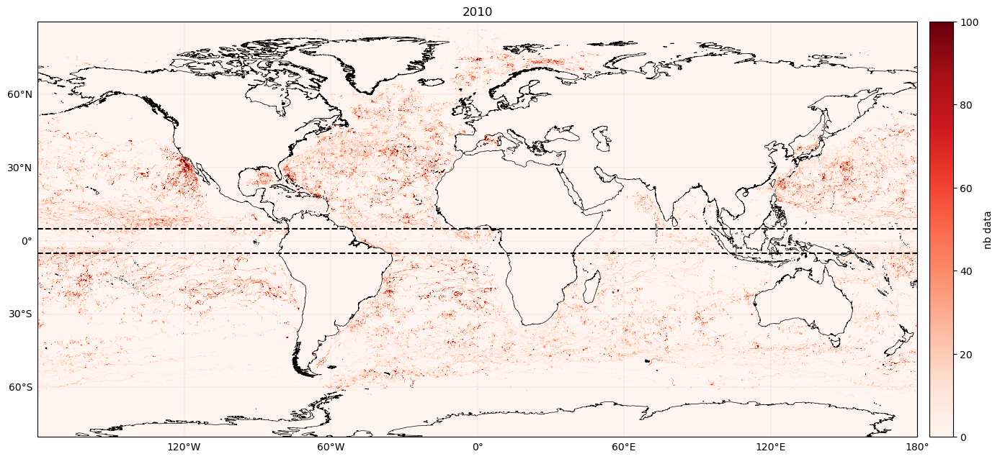

2011


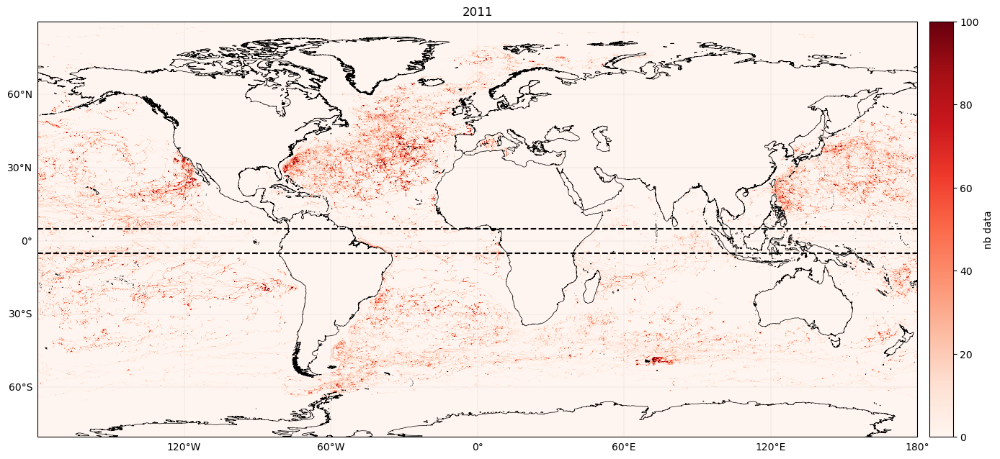

2012


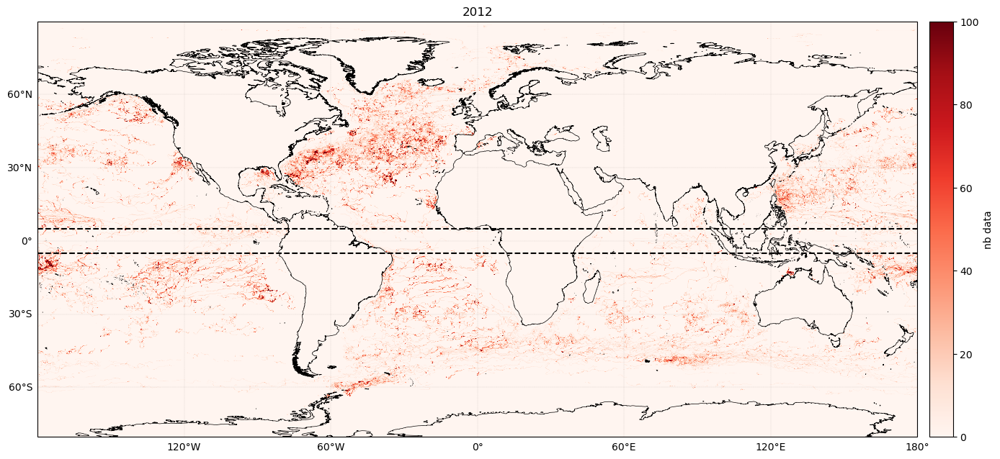

2013


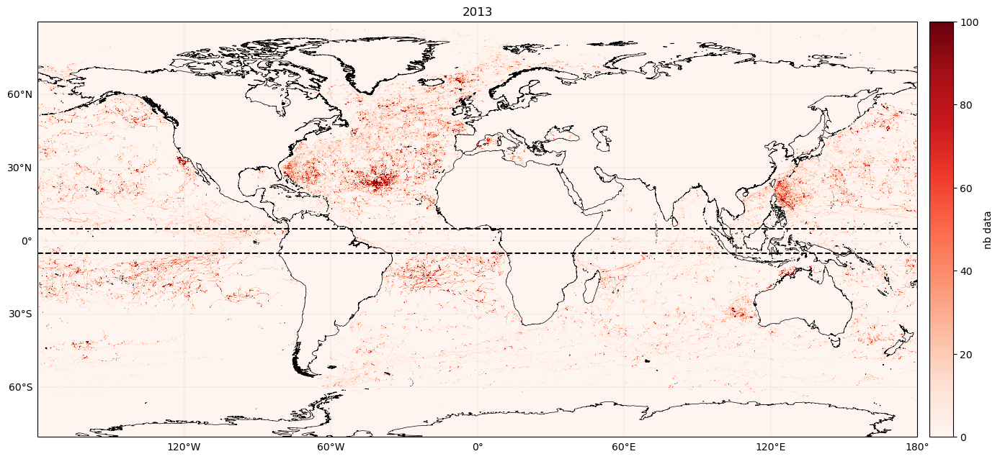

2014


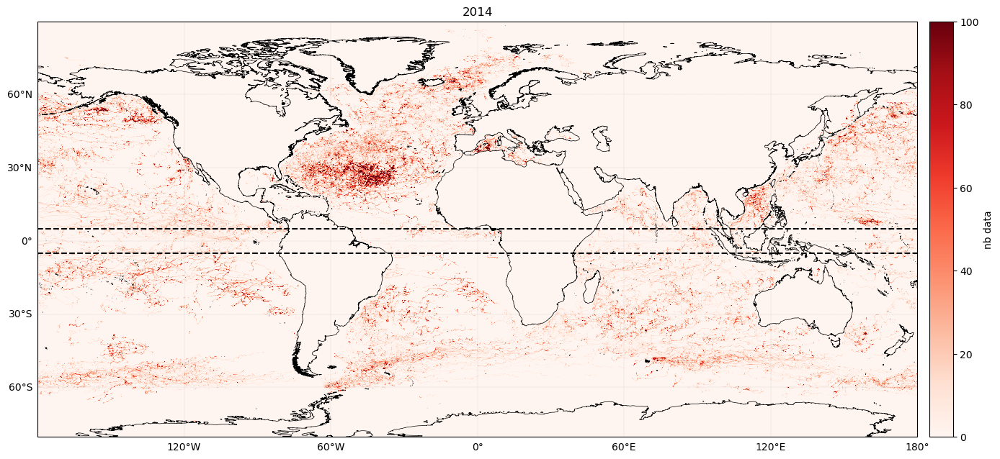

2015


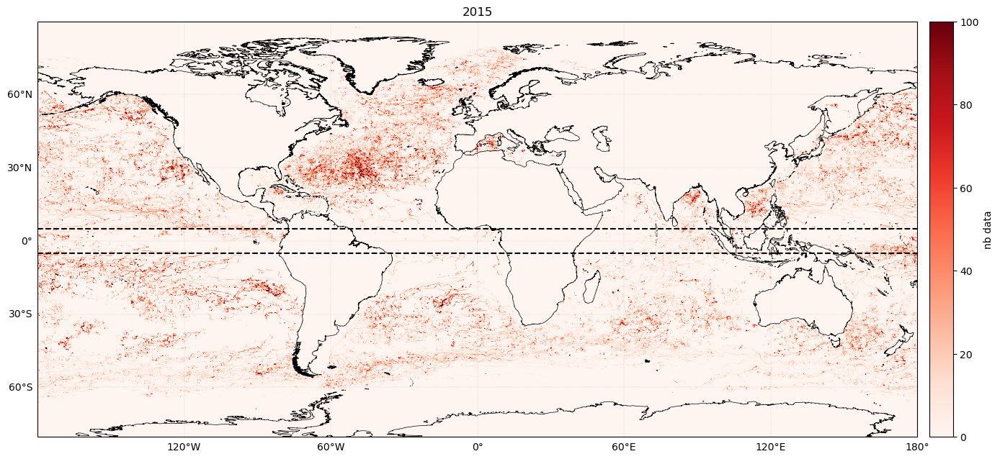

2016


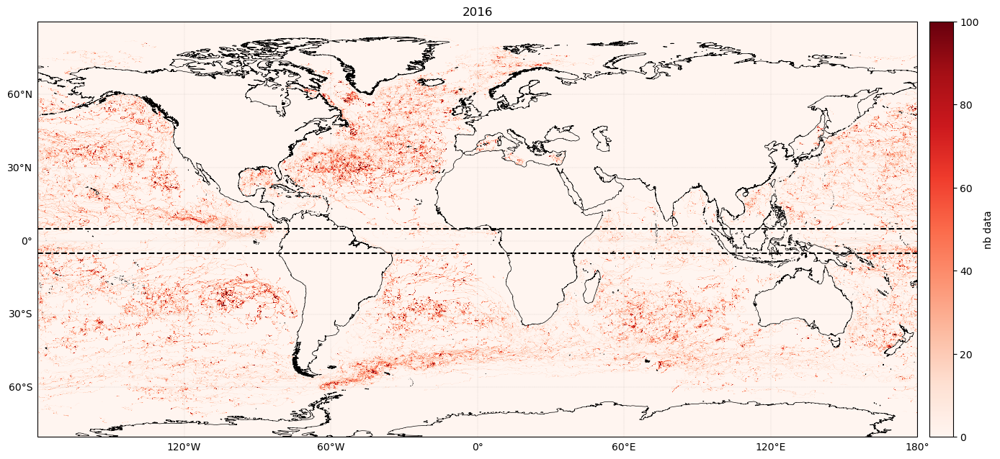

2017


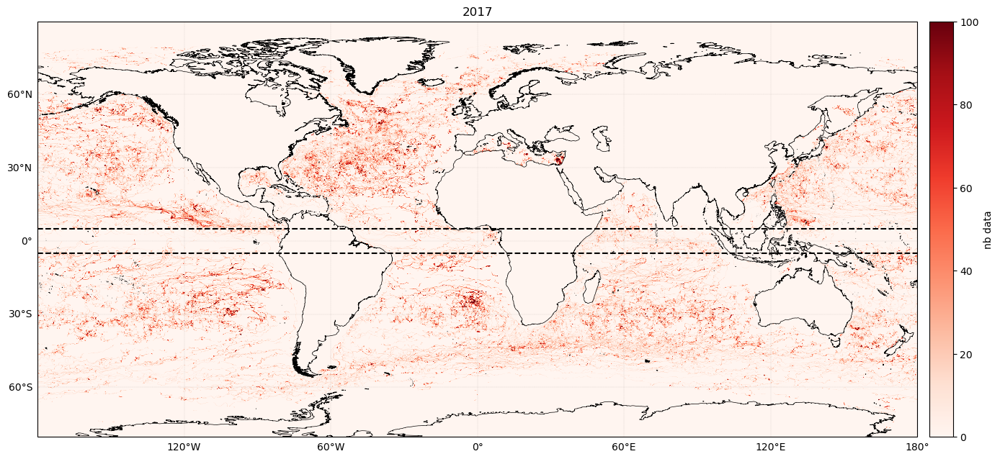

2018


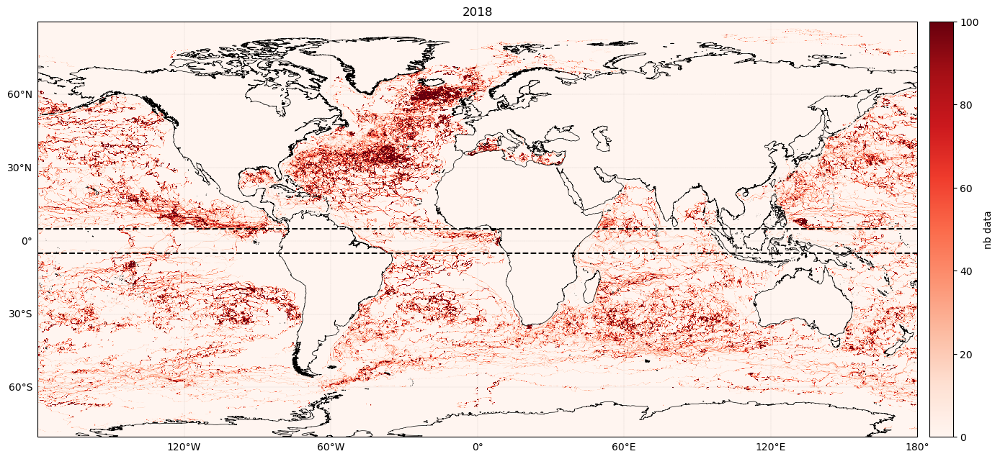

2019


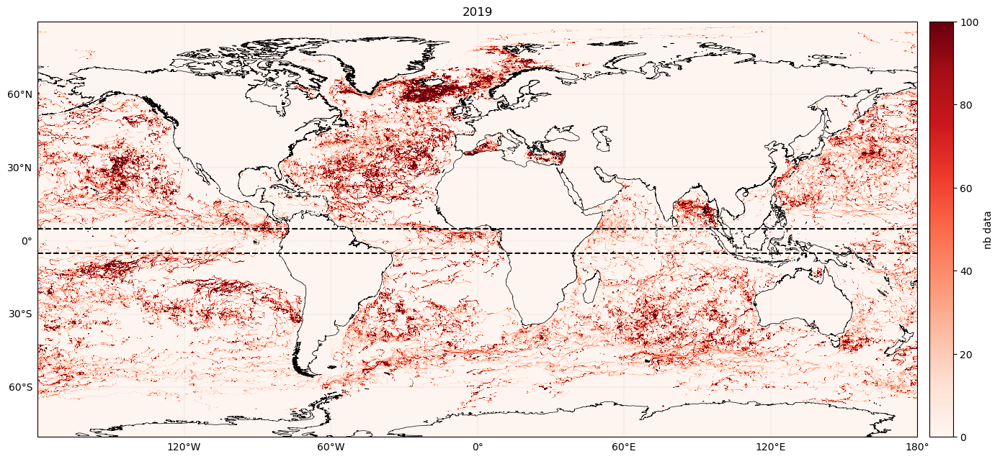

2020


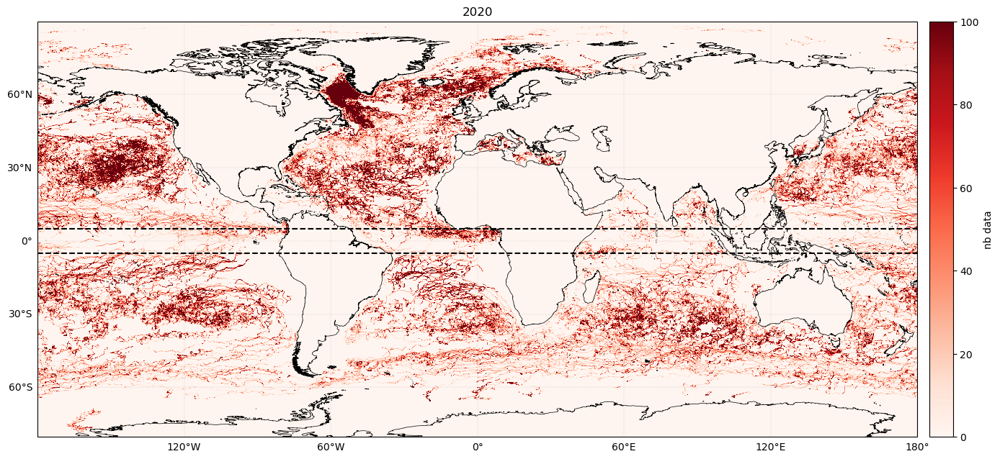

2021


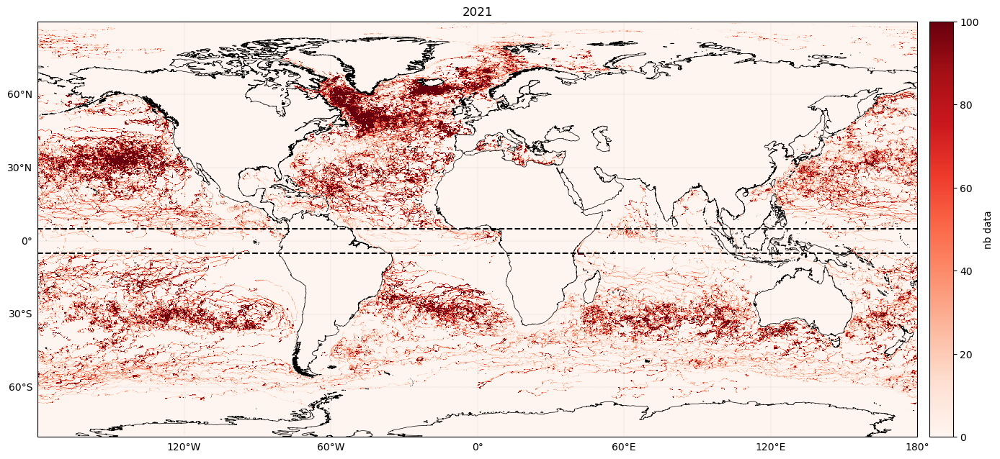

2022


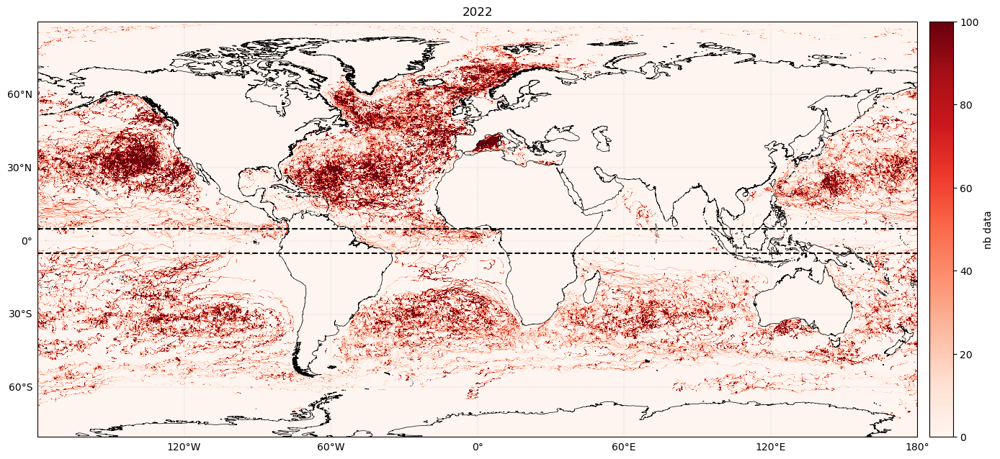

In [25]:
for year in range(2010,2023):
    print(year)
    filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/cmems/drifter_*_{year}.nc'))
    ds_drifter = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')
    histogram_da = compute_hist(ds_drifter)
    plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=100,colorbar_title="nb data",cmap=plt.cm.Reds,title=year)
    plt.savefig(f"plot/cmems/hist_drifter_cmems_{year}.png")
    plt.show()

2010


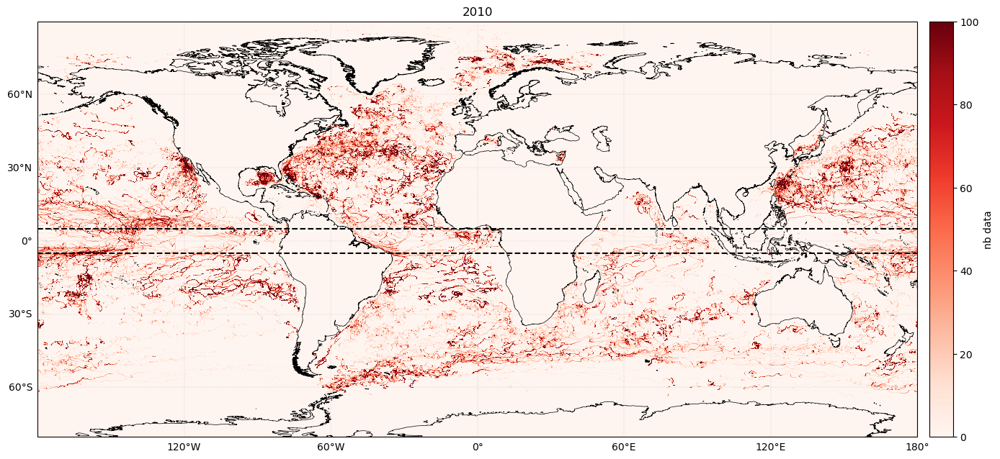

2011


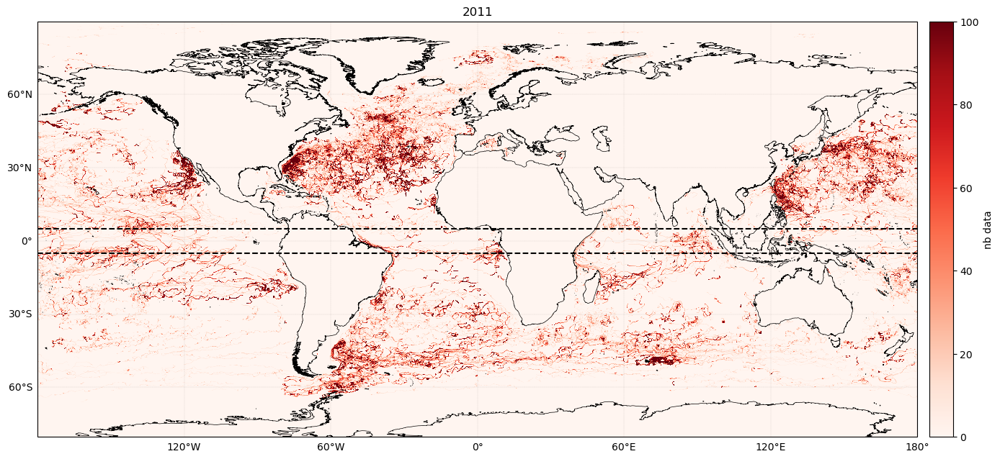

2012


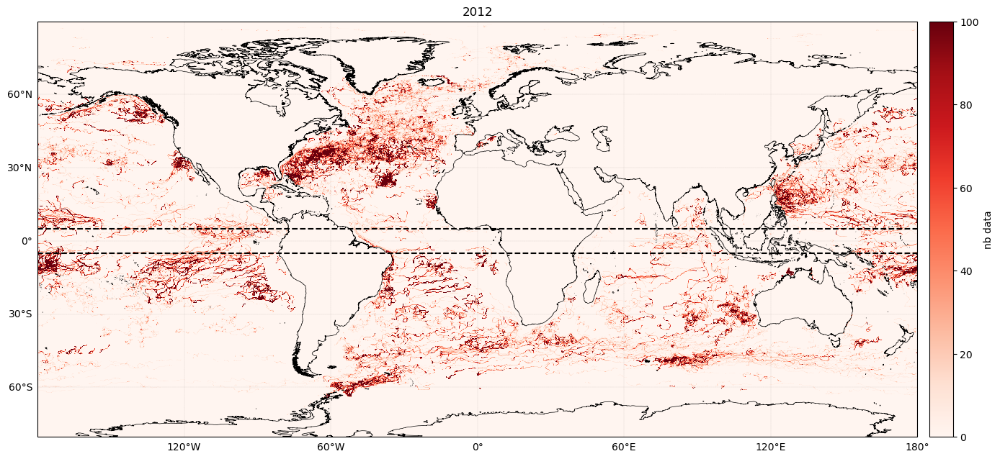

2013


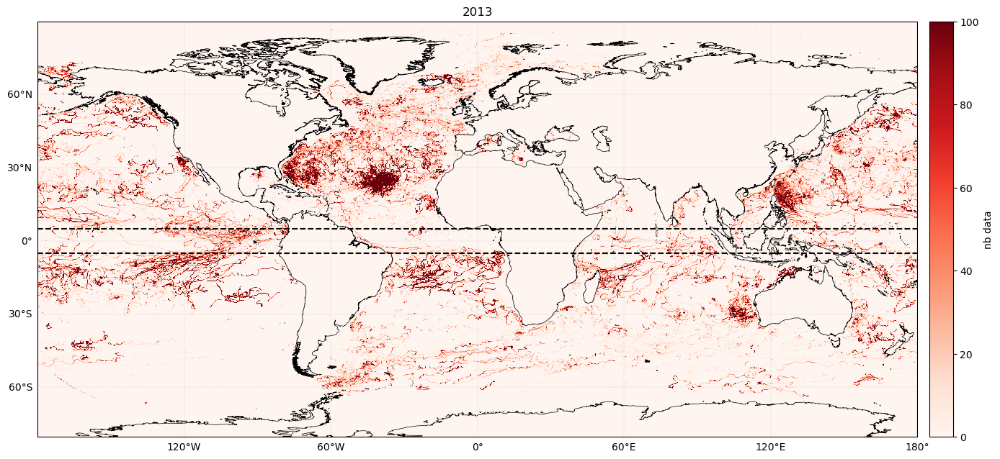

2014


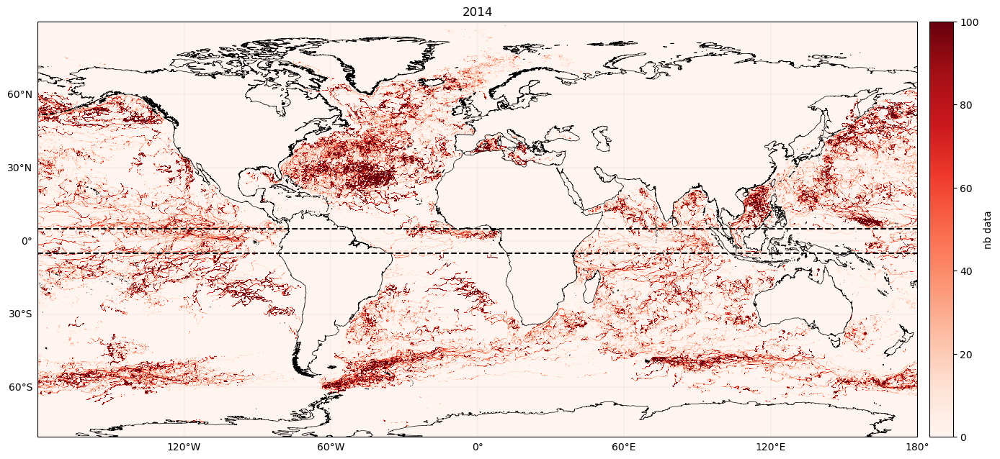

2015


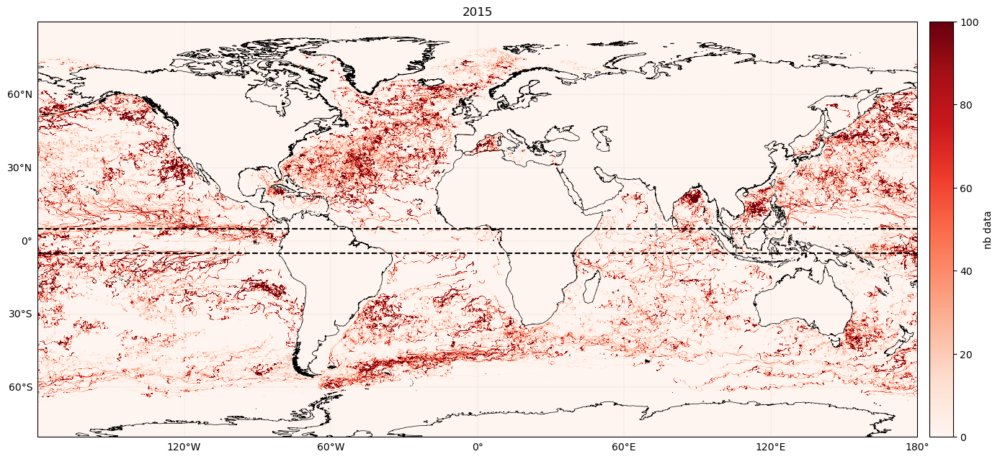

2016


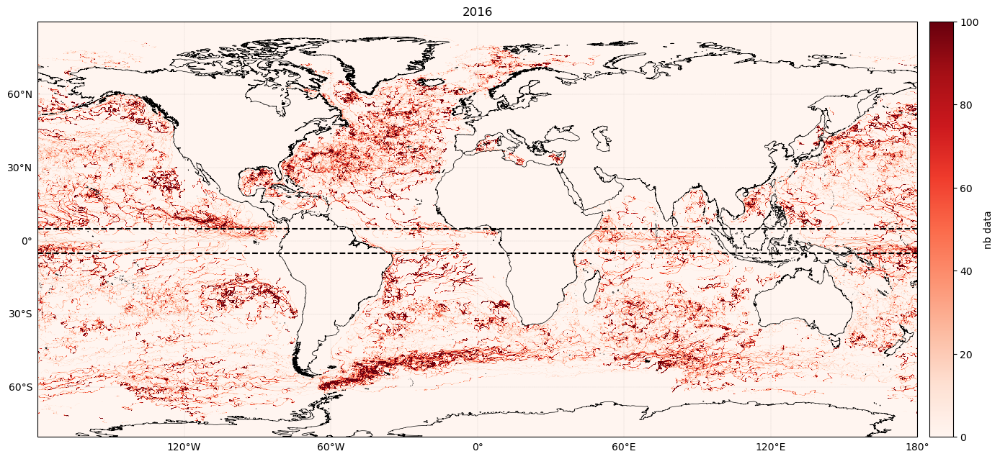

2017


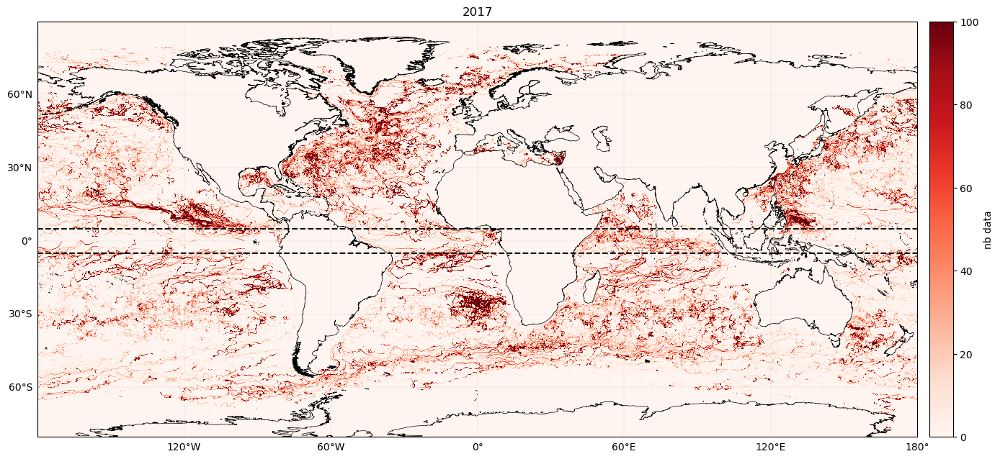

2018


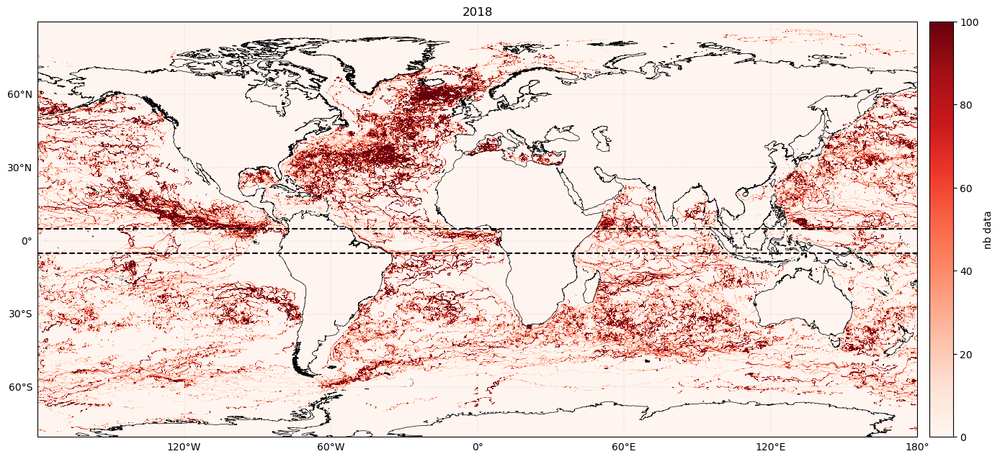

2019


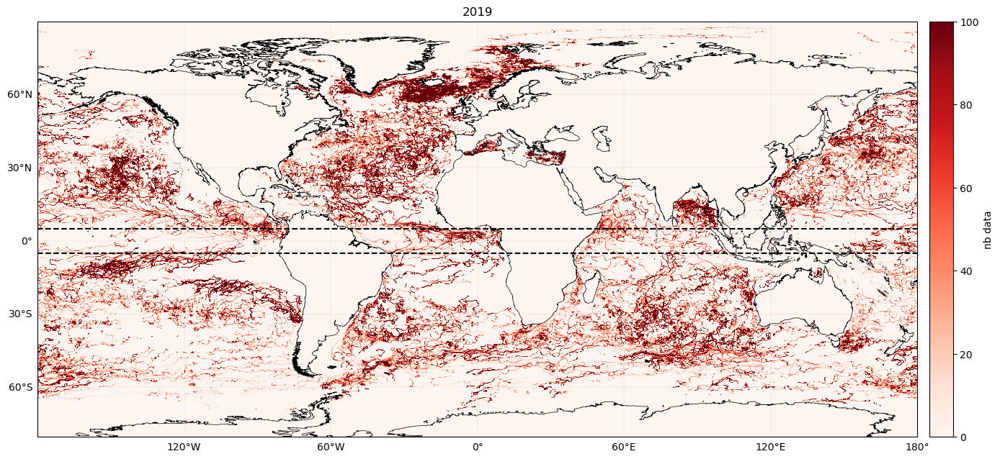

2020


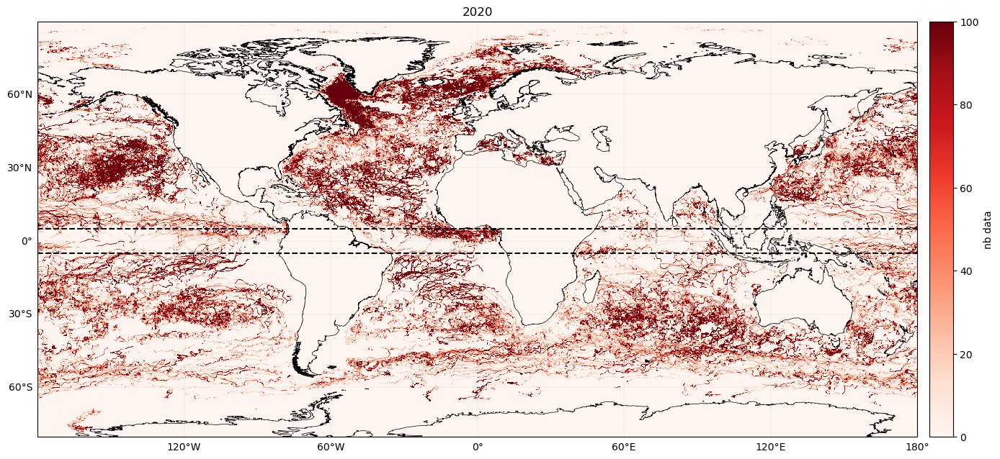

2021


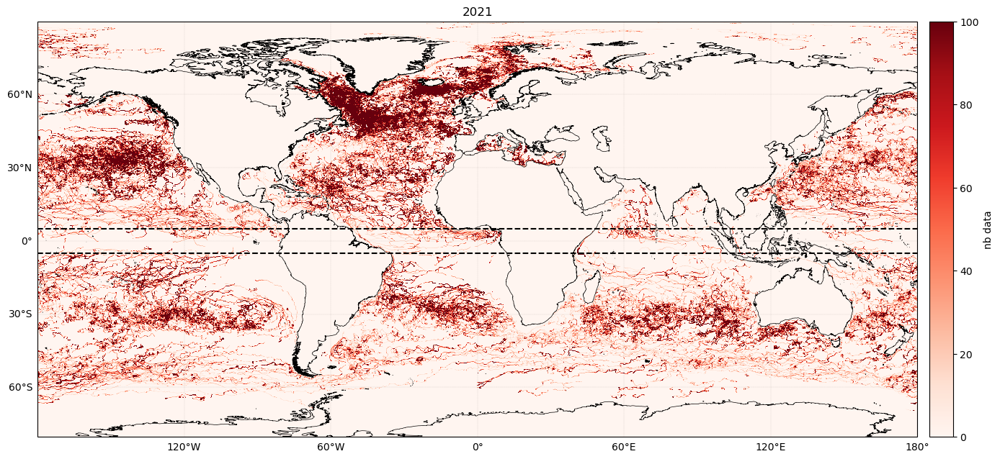

2022


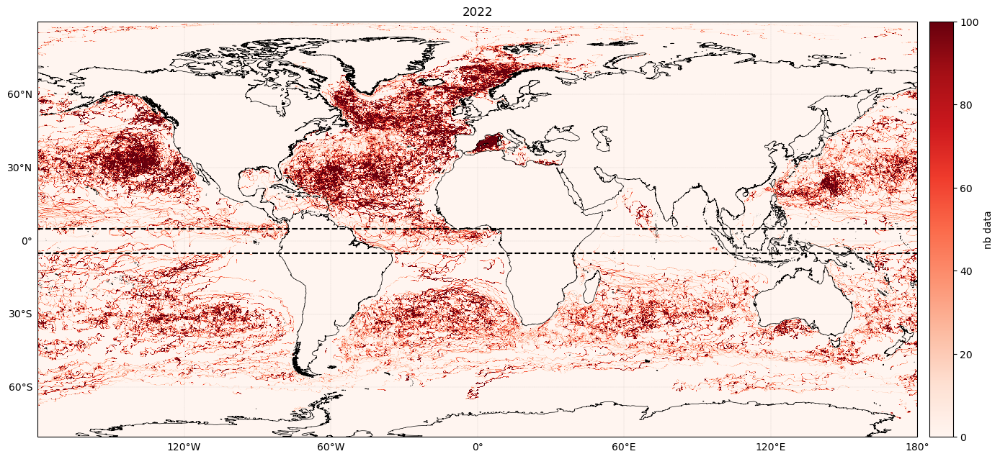

In [26]:
for year in range(2010,2023):
    print(year)
    filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/cmems/drifter_*_{year}.nc'))
    ds_drifter_cmems = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')
    filenames_drifters = sorted(glob(f'/Odyssey/public/drifters/aoml/drifter_*_{year}.nc'))
    ds_drifter_aoml = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='date')

    ds_drifter=xr.concat([ds_drifter_cmems, ds_drifter_aoml], dim="date")
    
    histogram_da = compute_hist(ds_drifter)
    plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=100,colorbar_title="nb data",cmap=plt.cm.Reds,title=year)
    plt.savefig(f"plot/aoml+cmems/hist_drifter_aoml+cmems_{year}.png")
    plt.show()

In [53]:
ds_drifter = xr.open_mfdataset('/Odyssey/private/t22picar/data/drifters/ftp-oceans.ncei.noaa.gov/pub/data.nodc/aoml/gdp/2010/drifter_6h_33064.nc')
ds_drifter = ds_drifter.squeeze("traj").compute()

In [54]:
time_min = '2010-01-01'                                        # time min for analysis
time_max = '2010-12-31'  
ds_drifter = ds_drifter.where((ds_drifter.time >= np.datetime64(time_min)) & (ds_drifter.time <=  np.datetime64(time_max)), drop=True)
ds_drifter


<xarray.Dataset> Size: 94kB
Dimensions:           (obs: 451)
Dimensions without coordinates: obs
Data variables: (12/26)
    ID                (obs) object 4kB b'33064' b'33064' ... b'33064' b'33064'
    rowsize           (obs) float64 4kB 451.0 451.0 451.0 ... 451.0 451.0 451.0
    WMO               (obs) float64 4kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    expno             (obs) float64 4kB 323.0 323.0 323.0 ... 323.0 323.0 323.0
    deploy_date       (obs) datetime64[ns] 4kB 2010-09-01 ... 2010-09-01
    deploy_lat        (obs) float64 4kB 49.8 49.8 49.8 49.8 ... 49.8 49.8 49.8
    ...                ...
    temp              (obs) float64 4kB 13.96 13.96 13.96 ... 7.16 7.115 7.107
    ve                (obs) float64 4kB nan -0.0409 -0.1145 ... -0.05655 nan
    vn                (obs) float64 4kB nan 0.3011 0.371 ... -0.1857 0.2277 nan
    err_temp          (obs) float64 4kB 0.05988 0.04104 ... 0.04102 0.04106
    err_lat           (obs) float64 4kB 0.004133 0.002922 ... 0.003728 0.002533
    err_lon           (obs) float64 4kB 0.005691 0.004042 ... 0.005061 0.00348
Attributes: (12/69)
    title:                      Global Drifter Program drifting buoy collection
    id:                         Global Drifter Program ID 33064
    wmo_platform_code:          0
    ncei_template_version:      NCEI_NetCDF_Trajectory_Template_v2
    cdm_data_type:              Trajectory
    history:                    From buoydata_15001_jul24.dat with metadata f...
    ...                         ...
    DrogueBallast:              3.5 kg
    DragAreaAboveDrogue:        35.75 m^2
    DragAreaOfDrogue:           840 m^2
    DragAreaRatio:              23.4965
    DrogueCenterDepth:          15 m
    DrogueDetectSensor:         submergence

In [59]:
histogram_da

<xarray.DataArray (lat_bin: 679, lon_bin: 1440)> Size: 8MB
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])
Coordinates:
  * lat_bin  (lat_bin) float64 5kB -80.12 -79.87 -79.62 ... 89.37 89.62 89.87
  * lon_bin  (lon_bin) float64 12kB -180.1 -179.9 -179.6 ... 179.3 179.5 179.8

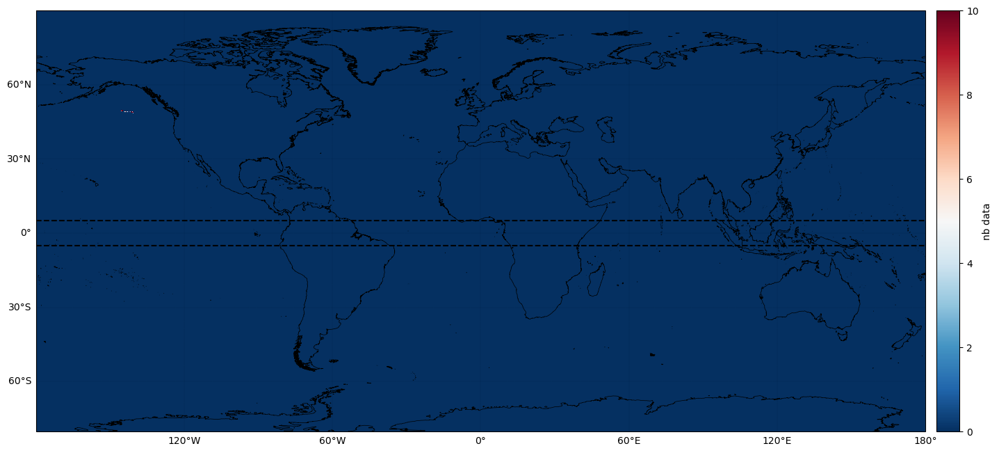

In [51]:
plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=10,colorbar_title="nb data")

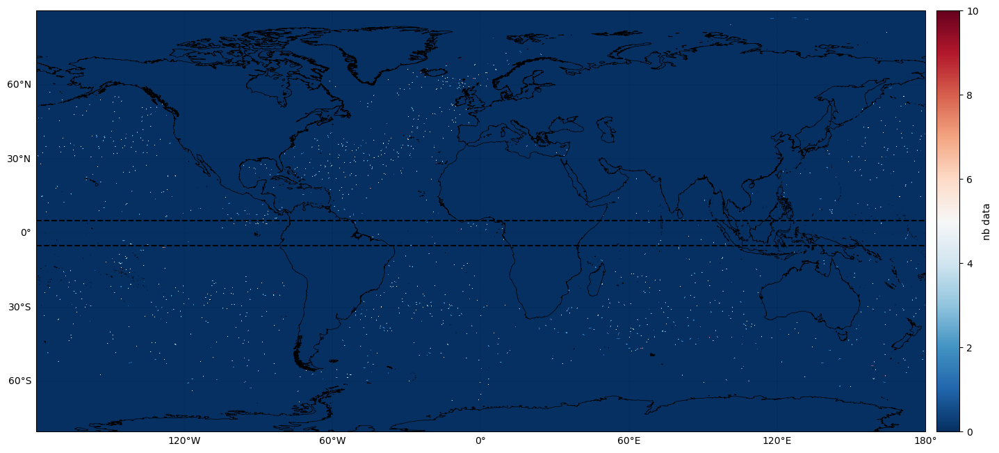

In [25]:
time_min = '2019-01-01'                                        # time min for analysis
time_max = '2019-01-02'  
ds_drifter = xr.open_mfdataset(filenames_drifters, combine='nested', concat_dim='time')
ds_drifter = ds_drifter.where((ds_drifter.time >= np.datetime64(time_min)) & (ds_drifter.time <=  np.datetime64(time_max)), drop=True)
ds_drifter


# Supposons que les variables de longitude et latitude soient nommées 'longitude' et 'latitude'
longitude = ds_drifter['longitude'].values
latitude = ds_drifter['latitude'].values

# Calculer le nombre de données dans chaque bin 2D
histogram, lat_edges, lon_edges = np.histogram2d(
    latitude, longitude, bins=[lat_bins, lon_bins]
)

# Convertir le résultat en xarray.DataArray pour une manipulation plus facile
histogram_da = xr.DataArray(
    histogram,
    coords=[('lat_bin', lat_edges[:-1]), ('lon_bin', lon_edges[:-1])],
    dims=['lat_bin', 'lon_bin'])

plot_uv_map(histogram_da,histogram_da.lon_bin,histogram_da.lat_bin,vmin=0,vmax=np.max(histogram_da),colorbar_title="nb data")

In [10]:

fig, axs = plt.subplots(nrows=1,ncols=1,
                    subplot_kw={'projection': ccrs.PlateCarree()},
                    figsize=(11,7.5))



p0 = axs.pcolormesh(lon_bins, lat_bins, histogram_da, cmap='jet',vmax=3000)

axs.set_title('Number of data from drifter (2019)')

axs.coastlines(resolution='10m', lw=0.5)
# optional add grid lines
p0.axes.gridlines(color='black', alpha=0., linestyle='--')
# draw parallels/meridiens and write labels
gl = p0.axes.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                        linewidth=0.1, color='black', alpha=0.5, linestyle='--')
# adjust labels to taste
gl.xlabels_top = False
gl.ylabels_right = False
gl.xlabels_bottom = False
gl.ylocator = mticker.FixedLocator([-90, -60, -30, 0, 30, 60, 90])
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 10, 'color': 'black'}
gl.ylabel_style = {'size': 10, 'color': 'black'}


cax = fig.add_axes([0.92, 0.37, 0.02, 0.25])
cbar = fig.colorbar(p0, cax=cax, orientation='vertical')
cax.set_ylabel('Number of data', fontweight='bold')



NameError: name 'ccrs' is not defined